# Dataset Creation

In [1]:
import pandas as pd
import numpy as np
import random
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')




# graph settings : 
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [2]:
def randomNumber(x):
    return random.randint(0,x)
def randomDate(x):
    return random.randint(5,x)
def randomYear(x):
    return random.randint(1,x)
def randomColor():
    r = lambda: random.randint(0,255)
    return ('#%02X%02X%02X' % (r(),r(),r()))
def randomDateCust():
    return random.randint(1,2)


In [3]:
# for ground owners
#(date-pk,year(not required),day, month, week number , groundName, timeslot chosen , sport chosen ) --> cost spent

years = ['2010','2011','2012','2013','2014','2015','2016','2017','2018','2019','2020','2021']

days = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

groundNames = ['Ground1','Ground2','Ground3','Ground4']

timeslots = ['timeslot1','timeslot2','timeslot3','timeslot4','timeslot5','timeslot6','timeslot7']

months = ['January','February','March','April','May','June','July','August','September','October','November','December']

sports = ['sport1','sport2','sport3','sport4','sport5','sport6']

#for ground 1 : 
g1_prices = {'sport1':100,'sport2':150,'sport3':250,'sport4':350,'sport5':400,'sport6':200}
g2_prices = {'sport1':200,'sport2':150,'sport3':450,'sport4':250,'sport5':200,'sport6':100}
g3_prices = {'sport1':350,'sport2':450,'sport3':150,'sport4':200,'sport5':300,'sport6':250}
g4_prices = {'sport1':450,'sport2':250,'sport3':150,'sport4':100,'sport5':250,'sport6':500}


data = [] 
data2=[]
# assuming on an average,30 people and minimum 5 people visit the ground everyday 
for i in range(1,3000):  
    num_dates = randomDate(30)
    tot_cost=0
    tYear =""
    tDay=""
    tGroundName=""
    tTimeSlot=""
    tMonth =""
    tSport=""
    tDate = i
    tot_cust = num_dates
    day_cost = []
    
    for j in range(1,tot_cust):    
        tDay = days[randomNumber(len(days)-1)]
        tGroundName = groundNames[randomNumber(len(groundNames)-1)]
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        tMonth = months[randomNumber(len(months)-1)]
        if(tGroundName == 'Ground1'):
            tCost = g1_prices[tSport]
            day_cost.append(tCost)
            tot_cost+=tCost
        elif(tGroundName == 'Ground2'):
            tCost = g2_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground3'):
            tCost = g3_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground4'):
            tCost = g4_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        if(i<250):
            tYear = years[0]
        elif(i>=250 and i<500):
            tYear = years[1]
        elif(i>=500 and i<750):
            tYear = years[2]
        elif(i>=750 and i<1000):
            tYear = years[3]
        elif(i>=1000 and i<1250):
            tYear = years[4]
        elif(i>=1250 and i<1500):
            tYear = years[5]
        elif(i>=1500 and i<1750):
            tYear = years[6]
        elif(i>=1750 and i<2000):
            tYear = years[7]
        elif(i>=2000 and i<2250):
            tYear = years[8]
        elif(i>=2250 and i<2500):
            tYear = years[9]
        elif(i>=2500 and i<2750):
            tYear = years[10]
        elif(i>=2750 and i<3000):
            tYear = years[11]
        
            
        
            
    
    data.append([tDate,tYear,tDay,tMonth,tGroundName,tot_cost,tot_cust])
    for i in range(1,tot_cust):
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        data2.append([tDate,tYear,tDay,tMonth,tTimeSlot,tSport,tGroundName,day_cost[i-1]])

groundOwners_df = pd.DataFrame(data, columns = ['Date','Year', 'Day','Month','GroundName','Cost','TotalCustomers'])

groundOwners_df_percust = pd.DataFrame(data2,columns = ['Date','Year', 'Day','Month','TimeSlot','Sport','GroundName','Cost'])

In [4]:
groundOwners_df

,Date,Year,Day,Month,GroundName,Cost,TotalCustomers
0,1,2010,Wednesday,February,Ground1,850,5
1,2,2010,Tuesday,August,Ground1,4100,15
2,3,2010,Tuesday,July,Ground1,7150,26
3,4,2010,Monday,February,Ground3,3700,17
4,5,2010,Tuesday,March,Ground1,4050,18
...,...,...,...,...,...,...,...
2994,2995,2021,Wednesday,January,Ground2,1300,7
2995,2996,2021,Tuesday,May,Ground2,6650,25
2996,2997,2021,Sunday,February,Ground3,4750,22
2997,2998,2021,Monday,August,Ground2,2400,13


In [5]:
groundOwners_df_percust

,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost
0,1,2010,Wednesday,February,timeslot2,sport6,Ground1,250
1,1,2010,Wednesday,February,timeslot6,sport4,Ground1,250
2,1,2010,Wednesday,February,timeslot4,sport3,Ground1,200
3,1,2010,Wednesday,February,timeslot6,sport1,Ground1,150
4,2,2010,Tuesday,August,timeslot1,sport6,Ground1,250
...,...,...,...,...,...,...,...,...
49671,2999,2021,Saturday,September,timeslot3,sport3,Ground2,150
49672,2999,2021,Saturday,September,timeslot6,sport2,Ground2,150
49673,2999,2021,Saturday,September,timeslot2,sport6,Ground2,300
49674,2999,2021,Saturday,September,timeslot2,sport2,Ground2,200


In [6]:
gO1_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground1']
gO2_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground2']
gO3_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground3']
gO4_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground4']

gO1_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground1']
gO2_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground2']
gO3_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground3']
gO4_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground4']



In [7]:
# gO1_Cost_df
# gO2_Cost_df
# gO3_Cost_df
# gO4_Cost_df

# gO1_Cust_df
# gO2_Cust_df
# gO3_Cust_df
# gO4_Cust_df

# Analytics of Dataset 

In [8]:
#for cost regression for all grounds: 
def HistCreateCostCategorical(gDF,x,cat):
    col_dis_seq = []
    for i in range(0,x):
        col_dis_seq.append(randomColor())
    fig = px.histogram(gDF, 
                       x='Cost', 
                       marginal='box', 
                       color=cat, 
                       color_discrete_sequence=col_dis_seq, 
                       title='Revenue of Ground based on '+cat)
    
    fig.update_layout(bargap=0.1)
    fig.show()

def HistCreateCategorical(gDF,cat):
    fig = px.histogram(gDF,x=cat,title="Number of people by "+cat)
    fig.show()

def HistCreateTwoCategorical(gDF,cat,secondCat):
    fig = px.histogram(gDF,x=cat,color=secondCat,title="Number of people by "+cat+" and"+secondCat)
    fig.show()
    

    
def CostWithOtherVars(gDF):
    fig = px.scatter(gDF,
                    x=other_var)

    
def FindCorrWithCost(gDF):
    day_values ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

    timeslot_values = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

    month_values = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

    sport_values = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}


    day_numeric =groundOwner1_df["Day"].map(day_values)
    print("Day with Cost :")
    print(groundOwner1_df["Cost"].corr(day_numeric))


    month_numeric =groundOwner1_df["Month"].map(month_values)
    print("Month with Cost :")
    print(groundOwner1_df["Cost"].corr(month_numeric))

    timeslot_numeric =groundOwner1_df["TimeSlot"].map(timeslot_values)
    print("TimeSlot with Cost :")
    print(groundOwner1_df["Cost"].corr(timeslot_numeric))

    sport_numeric =groundOwner1_df["Sport"].map(sport_values)
    print("Sport with Cost :")
    print(groundOwner1_df["Cost"].corr(sport_numeric))
    
    
def AnalyticsPipeline1(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
   
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



    
def AnalyticsPipeline2(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    HistCreateCostCategorical(gDF,11,'TimeSlot')
    HistCreateCostCategorical(gDF,11,'Sport')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    HistCreateCategorical(gDF,'TimeSlot')
    HistCreateCategorical(gDF,'Sport')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    HistCreateTwoCategorical(gDF,'Day','TimeSlot')
    HistCreateTwoCategorical(gDF,'Day','Sport')
    HistCreateTwoCategorical(gDF,'Sport','TimeSlot')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
    print("\nRelationship of Sport with Cost")
    temp_fig =px.violin(gDF,x="Sport",y="Cost",color="Day")
    temp_fig.show()
    
    print("\nRelationship of TimeSlot with Cost")
    temp_fig =px.violin(gDF,x="TimeSlot",y="Cost",color="Day")
    temp_fig.show()
    
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



In [9]:
AnalyticsPipeline1(gO1_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
0        1  2010  Wednesday  February    Ground1   850               5
1        2  2010    Tuesday    August    Ground1  4100              15
2        3  2010    Tuesday      July    Ground1  7150              26
4        5  2010    Tuesday     March    Ground1  4050              18
11      12  2010   Thursday   January    Ground1  2050               8
...    ...   ...        ...       ...        ...   ...             ...
2968  2969  2021    Tuesday      July    Ground1  1050               6
2976  2977  2021   Saturday  February    Ground1  3250              14
2983  2984  2021     Monday      July    Ground1  2300               7
2984  2985  2021     Monday  November    Ground1  3350              17
2989  2990  2021     Friday   January    Ground1  2450              10

[741 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 741 entries, 0 to 2989
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [10]:
AnalyticsPipeline1(gO2_Cost_df)

      Date  Year        Day      Month GroundName  Cost  TotalCustomers
5        6  2010     Friday   November    Ground2  5100              20
6        7  2010     Sunday        May    Ground2  2150               7
9       10  2010    Tuesday      March    Ground2  3700              18
13      14  2010     Sunday     August    Ground2  7750              26
14      15  2010    Tuesday      March    Ground2  5450              24
...    ...   ...        ...        ...        ...   ...             ...
2992  2993  2021     Monday    January    Ground2  1950               9
2994  2995  2021  Wednesday    January    Ground2  1300               7
2995  2996  2021    Tuesday        May    Ground2  6650              25
2997  2998  2021     Monday     August    Ground2  2400              13
2998  2999  2021   Saturday  September    Ground2  4550              21

[693 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 693 entries, 5 to 2998



Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [11]:
AnalyticsPipeline1(gO3_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
3        4  2010     Monday  February    Ground3  3700              17
8        9  2010   Thursday    August    Ground3  5050              20
10      11  2010  Wednesday       May    Ground3  3000              13
22      23  2010  Wednesday   October    Ground3  6750              28
25      26  2010     Sunday   October    Ground3  2400              12
...    ...   ...        ...       ...        ...   ...             ...
2981  2982  2021   Thursday     March    Ground3  3800              17
2982  2983  2021  Wednesday   January    Ground3  3100              14
2985  2986  2021   Thursday      June    Ground3  3800              13
2988  2989  2021  Wednesday       May    Ground3  2450              10
2996  2997  2021     Sunday  February    Ground3  4750              22

[784 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 784 entries, 3 to 2996
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [12]:
AnalyticsPipeline1(gO4_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
7        8  2010  Wednesday     April    Ground4  6800              28
12      13  2010   Saturday       May    Ground4  5600              22
18      19  2010    Tuesday       May    Ground4  4500              17
19      20  2010     Friday     April    Ground4  2250              10
28      29  2010     Sunday       May    Ground4  2250              10
...    ...   ...        ...       ...        ...   ...             ...
2977  2978  2021     Friday     April    Ground4  5050              20
2978  2979  2021   Thursday  February    Ground4  2450              13
2986  2987  2021   Thursday  November    Ground4  1550               8
2990  2991  2021     Sunday   October    Ground4  5100              19
2993  2994  2021   Thursday   January    Ground4  3000              12

[781 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 781 entries, 7 to 2993
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [13]:
AnalyticsPipeline2(gO1_Cust_df)

       Date  Year        Day     Month   TimeSlot   Sport GroundName  Cost
0         1  2010  Wednesday  February  timeslot2  sport6    Ground1   250
1         1  2010  Wednesday  February  timeslot6  sport4    Ground1   250
2         1  2010  Wednesday  February  timeslot4  sport3    Ground1   200
3         1  2010  Wednesday  February  timeslot6  sport1    Ground1   150
4         2  2010    Tuesday    August  timeslot1  sport6    Ground1   250
...     ...   ...        ...       ...        ...     ...        ...   ...
49530  2990  2021     Friday   January  timeslot2  sport2    Ground1   400
49531  2990  2021     Friday   January  timeslot4  sport1    Ground1   200
49532  2990  2021     Friday   January  timeslot4  sport2    Ground1   200
49533  2990  2021     Friday   January  timeslot6  sport5    Ground1   150
49534  2990  2021     Friday   January  timeslot4  sport4    Ground1   250

[12348 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [14]:
AnalyticsPipeline2(gO2_Cust_df)

       Date  Year       Day      Month   TimeSlot   Sport GroundName  Cost
76        6  2010    Friday   November  timeslot6  sport2    Ground2   250
77        6  2010    Friday   November  timeslot4  sport3    Ground2   500
78        6  2010    Friday   November  timeslot7  sport4    Ground2   450
79        6  2010    Friday   November  timeslot4  sport4    Ground2   100
80        6  2010    Friday   November  timeslot3  sport6    Ground2   100
...     ...   ...       ...        ...        ...     ...        ...   ...
49671  2999  2021  Saturday  September  timeslot3  sport3    Ground2   150
49672  2999  2021  Saturday  September  timeslot6  sport2    Ground2   150
49673  2999  2021  Saturday  September  timeslot2  sport6    Ground2   300
49674  2999  2021  Saturday  September  timeslot2  sport2    Ground2   200
49675  2999  2021  Saturday  September  timeslot6  sport6    Ground2   250

[11382 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [15]:
AnalyticsPipeline2(gO3_Cust_df)

       Date  Year     Day     Month   TimeSlot   Sport GroundName  Cost
43        4  2010  Monday  February  timeslot2  sport5    Ground3   350
44        4  2010  Monday  February  timeslot2  sport1    Ground3   100
45        4  2010  Monday  February  timeslot3  sport5    Ground3   200
46        4  2010  Monday  February  timeslot7  sport3    Ground3   150
47        4  2010  Monday  February  timeslot3  sport5    Ground3   150
...     ...   ...     ...       ...        ...     ...        ...   ...
49639  2997  2021  Sunday  February  timeslot2  sport1    Ground3   150
49640  2997  2021  Sunday  February  timeslot4  sport3    Ground3   150
49641  2997  2021  Sunday  February  timeslot4  sport4    Ground3   450
49642  2997  2021  Sunday  February  timeslot3  sport1    Ground3   150
49643  2997  2021  Sunday  February  timeslot1  sport3    Ground3   200

[12955 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 12955 entries, 43 to 


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [16]:
AnalyticsPipeline2(gO4_Cust_df)

       Date  Year        Day    Month   TimeSlot   Sport GroundName  Cost
101       8  2010  Wednesday    April  timeslot5  sport1    Ground4   150
102       8  2010  Wednesday    April  timeslot2  sport2    Ground4   200
103       8  2010  Wednesday    April  timeslot1  sport4    Ground4   300
104       8  2010  Wednesday    April  timeslot2  sport2    Ground4   350
105       8  2010  Wednesday    April  timeslot4  sport5    Ground4   300
...     ...   ...        ...      ...        ...     ...        ...   ...
49588  2994  2021   Thursday  January  timeslot5  sport4    Ground4   250
49589  2994  2021   Thursday  January  timeslot4  sport3    Ground4   450
49590  2994  2021   Thursday  January  timeslot4  sport5    Ground4   450
49591  2994  2021   Thursday  January  timeslot5  sport5    Ground4   450
49592  2994  2021   Thursday  January  timeslot6  sport1    Ground4   100

[12991 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Inde


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [17]:
# correlation 
day_codes ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

timeslot_codes = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

month_codes = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

sport_codes = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}

def correlation_matrix_ground(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
#     gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
#     gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data')
    
def correlation_matrix_cust(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
    gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
    gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data');



AxesSubplot(0.125,0.125;0.62x0.755)


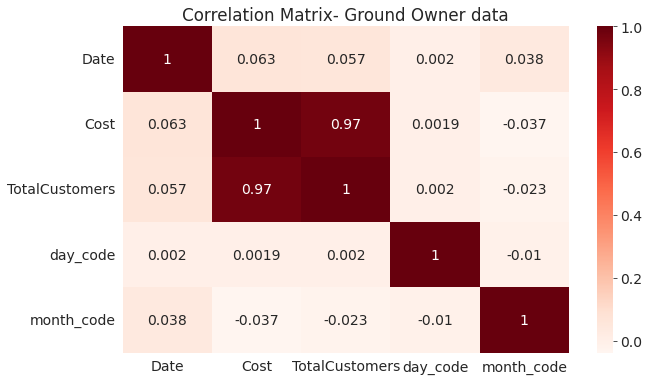

In [18]:
correlation_matrix_ground(gO1_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


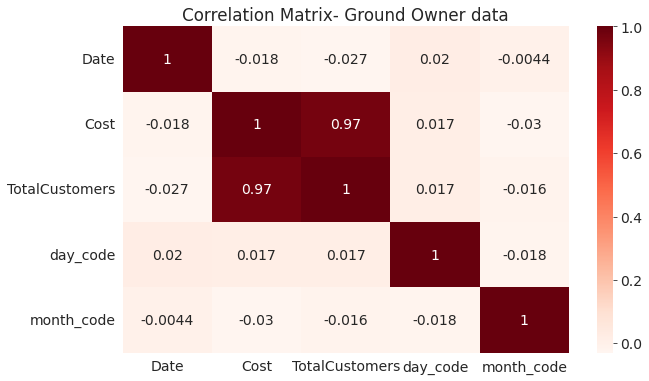

In [19]:
correlation_matrix_ground(gO2_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


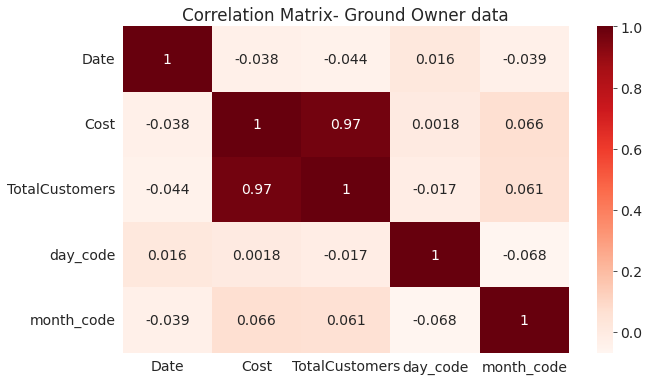

In [20]:
correlation_matrix_ground(gO3_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


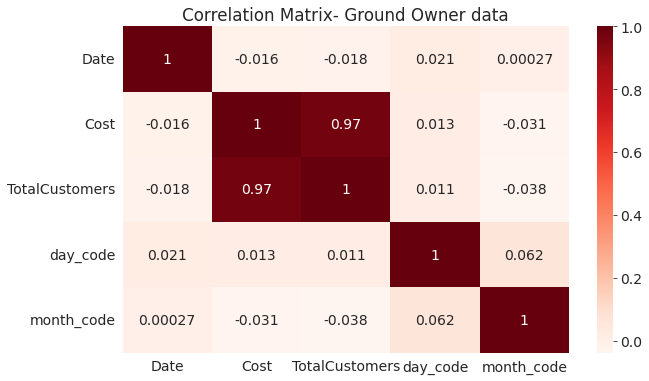

In [21]:
correlation_matrix_ground(gO4_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


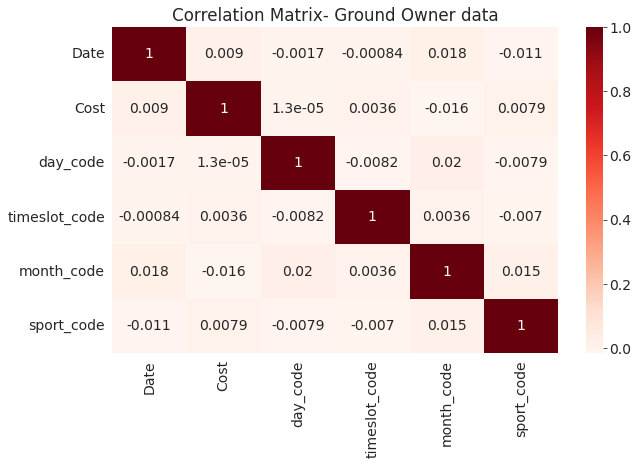

In [22]:
correlation_matrix_cust(gO1_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


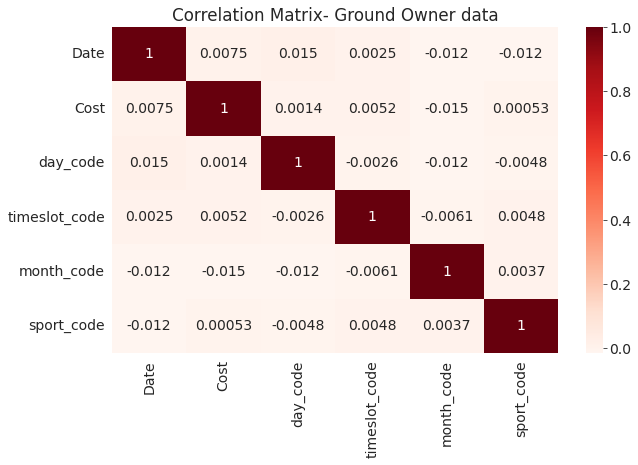

In [23]:
correlation_matrix_cust(gO2_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


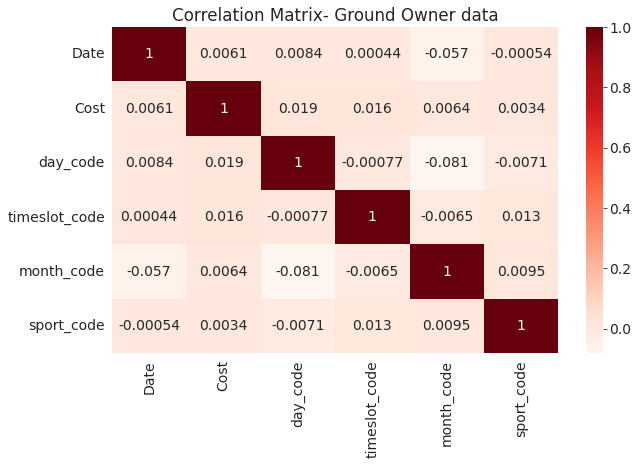

In [24]:
correlation_matrix_cust(gO3_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


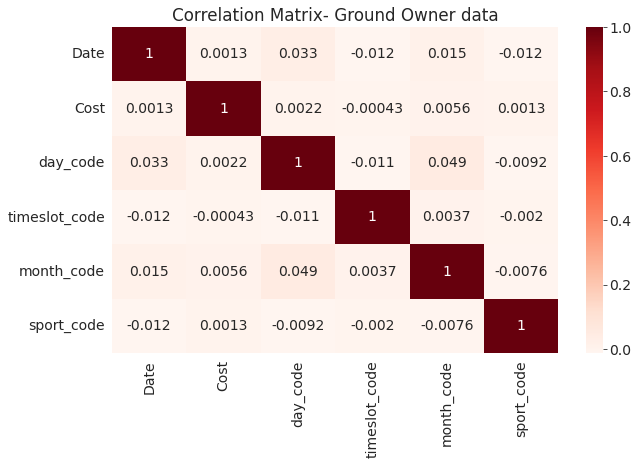

In [25]:
correlation_matrix_cust(gO4_Cust_df)

# Preprocessing for fitting into Models

In [26]:
print(gO1_Cost_df.shape)
gO1_Cost_df.head()

(741, 9)


,Date,Year,Day,Month,GroundName,Cost,TotalCustomers,day_code,month_code
0,1,2010,Wednesday,February,Ground1,850,5,2,1
1,2,2010,Tuesday,August,Ground1,4100,15,1,7
2,3,2010,Tuesday,July,Ground1,7150,26,1,6
4,5,2010,Tuesday,March,Ground1,4050,18,1,2
11,12,2010,Thursday,January,Ground1,2050,8,3,0


In [27]:
gO1_Cost_df.nunique()

Date              741
Year               12
Day                 7
Month              12
GroundName          1
Cost              158
TotalCustomers     26
day_code            7
month_code         12
dtype: int64

In [28]:
gO1_Cost_df = gO1_Cost_df.drop(['Date','Year','GroundName','day_code','month_code'],axis=1)
# gO1_Cost_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
gO1_Cost_df.head()

,Day,Month,Cost,TotalCustomers
0,Wednesday,February,850,5
1,Tuesday,August,4100,15
2,Tuesday,July,7150,26
4,Tuesday,March,4050,18
11,Thursday,January,2050,8


In [29]:
gO1_Cost_df.shape

(741, 4)

In [30]:
print(gO1_Cust_df.shape)
gO1_Cust_df.head()

(12348, 12)


,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost,day_code,timeslot_code,month_code,sport_code
0,1,2010,Wednesday,February,timeslot2,sport6,Ground1,250,2,1,1,5
1,1,2010,Wednesday,February,timeslot6,sport4,Ground1,250,2,5,1,3
2,1,2010,Wednesday,February,timeslot4,sport3,Ground1,200,2,3,1,2
3,1,2010,Wednesday,February,timeslot6,sport1,Ground1,150,2,5,1,0
4,2,2010,Tuesday,August,timeslot1,sport6,Ground1,250,1,0,7,5


In [31]:
gO1_Cust_df.nunique()

Date             741
Year              12
Day                7
Month             12
TimeSlot           7
Sport              6
GroundName         1
Cost               9
day_code           7
timeslot_code      7
month_code        12
sport_code         6
dtype: int64

In [32]:
gO1_Cust_df = gO1_Cust_df.drop(['Date','Year','GroundName','day_code','month_code','timeslot_code','sport_code'],axis=1)
# gO1_Cust_df = pd.get_dummies(gO1_Cust_df,drop_first=True)
gO1_Cust_df.head()

,Day,Month,TimeSlot,Sport,Cost
0,Wednesday,February,timeslot2,sport6,250
1,Wednesday,February,timeslot6,sport4,250
2,Wednesday,February,timeslot4,sport3,200
3,Wednesday,February,timeslot6,sport1,150
4,Tuesday,August,timeslot1,sport6,250


In [33]:
gO1_Cust_df.columns

Index(['Day', 'Month', 'TimeSlot', 'Sport', 'Cost'], dtype='object')

# Predicting Total cost of the ground on a day

## Simple Linear Regression

In [34]:
linear_1 = gO1_Cost_df[['TotalCustomers','Cost']]
print(linear_1.shape)
linear_1.head()

(741, 2)


,TotalCustomers,Cost
0,5,850
1,15,4100
2,26,7150
4,18,4050
11,8,2050


Text(0, 0.5, 'Revenue of that day')

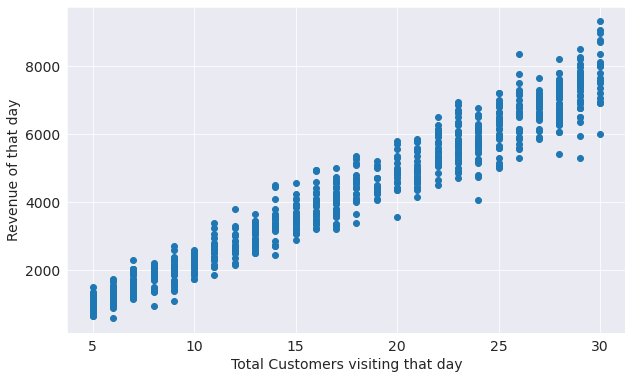

In [35]:
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [36]:
linear_1_X = linear_1.iloc[:,0:1]
linear_1_y = linear_1.iloc[:,-1]

In [37]:
linear_1_X.head()

,TotalCustomers
0,5
1,15
2,26
4,18
11,8


In [38]:
linear_1_y.head()

0      850
1     4100
2     7150
4     4050
11    2050
Name: Cost, dtype: int64

In [39]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(linear_1_X,linear_1_y,test_size = 0.2,random_state=2)

In [40]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
lr_1 = LinearRegression()


In [41]:
lr_1.fit(X_train,y_train)

LinearRegression()

In [42]:
X_test.head()

,TotalCustomers
2875,17
2612,30
651,15
171,29
2240,9


In [43]:
y_test.head()

2875    4450
2612    6900
651     3150
171     7650
2240    2300
Name: Cost, dtype: int64

In [44]:
X_test.iloc[1]

TotalCustomers    30
Name: 2612, dtype: int64

In [45]:
lr_1.predict(X_test.iloc[1].values.reshape(1,1))

array([7510.61267216])

In [46]:
#regression metrics 


Text(0, 0.5, 'Revenue of that day')

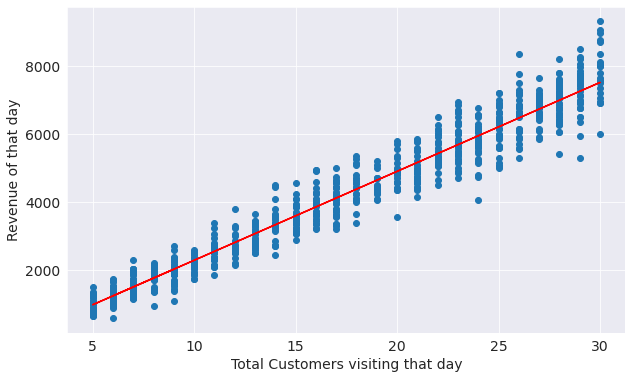

In [47]:
# line of best fit : 
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.plot(X_train.to_numpy(),lr_1.predict(X_train),color='red')
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [48]:
w_lr_1 = lr_1.coef_
b_lr_1 = lr_1.intercept_
print('weight:'+str(w_lr_1))
print('bias :'+str(b_lr_1))
# revenue = w * totalCust + b

weight:[260.89778745]
bias :-316.3209513313923


## Multiple Linear Regression

In [49]:
gO1_Cost_df

,Day,Month,Cost,TotalCustomers
0,Wednesday,February,850,5
1,Tuesday,August,4100,15
2,Tuesday,July,7150,26
4,Tuesday,March,4050,18
11,Thursday,January,2050,8
...,...,...,...,...
2968,Tuesday,July,1050,6
2976,Saturday,February,3250,14
2983,Monday,July,2300,7
2984,Monday,November,3350,17


In [50]:
linear_2 = pd.get_dummies(gO1_Cost_df,drop_first=True)
print(linear_2.shape)
print(linear_2.columns)
linear_2.head()

(741, 19)
Index(['Cost', 'TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')


,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
0,850,5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0
1,4100,15,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0
2,7150,26,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,4050,18,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
11,2050,8,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0


In [51]:
# 18 dimensional hyperplane
# cost = b0 + b1.totCust + b2.day_mon + ... +b17.month_sept 


In [52]:
linear_2_X = linear_2.iloc[:,1:]
linear_2_y = linear_2.iloc[:,0]

In [53]:
print(linear_2_X.shape)
print(linear_2_y.shape)

(741, 18)
(741,)


In [259]:
linear_2_X

,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
0,5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0
1,15,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0
2,26,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,18,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
11,8,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,6,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
2976,14,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2983,7,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2984,17,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [260]:
linear_2_y

0        850
1       4100
2       7150
4       4050
11      2050
        ... 
2968    1050
2976    3250
2983    2300
2984    3350
2989    2450
Name: Cost, Length: 741, dtype: int64

In [261]:
X_train,X_test,y_train,y_test = train_test_split(linear_2_X,linear_2_y,test_size=0.2,random_state=2)

In [262]:
lr_2 = LinearRegression()

In [263]:
lr_2.fit(X_train,y_train)

LinearRegression()

In [264]:
y_pred = lr_2.predict(X_test)

In [265]:
r2_score(y_test,y_pred)

0.9430369542258029

In [266]:
lr_2.coef_ # b1 to b17

array([260.30066914,  38.39186003, -42.2271846 ,  14.82066344,
        -8.85295431,  50.14141062, -51.52688941, 245.44783348,
        72.76763421, 174.03365074, 128.73317997,  69.60887317,
       190.37042357, 219.72678124, 140.38724456, -26.33871846,
        -1.16103123, 167.24067523])

In [267]:
lr_2.intercept_ # bias

-428.42079724402447

In [268]:
# evalutaion metric s: MAE , MSE , RMSE , R2Score , Adjusted R2 score
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

In [271]:
y_pred=lr_2.predict(X_test)

In [281]:
print("MAE: Rs.",mean_absolute_error(y_test,y_pred))
print("MSE",mean_squared_error(y_test,y_pred))
print("RMSE: Rs.",np.sqrt(mean_squared_error(y_test,y_pred)))
r2=r2_score(y_test,y_pred)
print("R2Score :",r2)


MAE: Rs. 374.12478676078246
MSE 238788.10775465262
RMSE: Rs. 488.6595008333028
R2Score : 0.9430369542258029


## Polynomial Regression (ohe)

In [282]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression,SGDRegressor
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.metrics import r2_score
from sklearn.pipeline import Pipeline

In [283]:
linear_3 = pd.get_dummies(gO1_Cost_df,drop_first=True)
print(linear_3.shape)
print(linear_3.columns)
linear_3.head()

(741, 19)
Index(['Cost', 'TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')


,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
0,850,5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0
1,4100,15,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0
2,7150,26,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,4050,18,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
11,2050,8,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0


In [284]:
linear_3_X = linear_3.iloc[:,1:]
linear_3_y = linear_3.iloc[:,0]

In [285]:
linear_3_y.head()

0      850
1     4100
2     7150
4     4050
11    2050
Name: Cost, dtype: int64

In [286]:
linear_3_X.head()

,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
0,5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0
1,15,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0
2,26,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,18,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
11,8,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0


In [287]:
X_train,X_test,y_train,y_test = train_test_split(linear_3_X,linear_3_y,test_size=0.2,random_state=2)

In [288]:
poly = PolynomialFeatures(degree = 2)
X_linear3_trans = poly.fit_transform(X_train)
X_linear3_trans

array([[ 1.,  6.,  0., ...,  0.,  0.,  0.],
       [ 1., 12.,  0., ...,  0.,  0.,  1.],
       [ 1., 16.,  1., ...,  0.,  0.,  0.],
       ...,
       [ 1., 12.,  0., ...,  0.,  0.,  0.],
       [ 1., 10.,  1., ...,  0.,  0.,  0.],
       [ 1.,  9.,  0., ...,  0.,  0.,  0.]])

In [289]:
lr_3 = LinearRegression()
lr_3.fit(X_linear3_trans,y_train)

LinearRegression()

In [290]:
X_linear3_test = poly.transform(X_test)
y_pred = lr_3.predict(X_linear3_test)

In [293]:
# y_pred

In [292]:
r2_score(y_test,y_pred)

0.9326745960860151

## Ridge Regression(ohe) (mse, sgd)

In [343]:
linear_4 = pd.get_dummies(gO1_Cost_df,drop_first=True)
linear_4

,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
0,850,5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0
1,4100,15,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0
2,7150,26,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,4050,18,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
11,2050,8,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1050,6,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
2976,3250,14,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2983,2300,7,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2984,3350,17,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [344]:
linear_4_X = linear_4.iloc[:,1:]
linear_4_y = linear_4.iloc[:,0]

In [345]:
print(linear_4_X.shape)
print(linear_4_y.shape)

(741, 18)
(741,)


In [346]:
X_train,X_test,y_train,y_test = train_test_split(linear_4_X,linear_4_y,test_size=0.2,random_state=2)

In [350]:
from sklearn.linear_model import Ridge
from sklearn.metrics import r2_score,mean_squared_error
l4_ridge = Ridge(alpha = 0.0001)
l4_ridge.fit(X_train,y_train)

Ridge(alpha=0.0001)

In [351]:
y_pred = l4_ridge.predict(X_test)

In [353]:
print("R2 score : ",r2_score(y_pred,y_test))
print("RMSE :",np.sqrt(mean_squared_error(y_test,y_pred)))

R2 score :  0.9368677437287304
RMSE : 488.6593963310083


In [356]:
from sklearn.linear_model import SGDRegressor
l4_sgd = SGDRegressor(max_iter = 500,learning_rate="constant",alpha=0.001)

In [357]:
l4_sgd.fit(X_train,y_train)

SGDRegressor(alpha=0.001, learning_rate='constant', max_iter=500)

In [360]:
y_pred = l4_sgd.predict(X_test)
print("R2 score:",r2_score(y_pred,y_test))

R2 score: -5.316607026993574


In [363]:
l4_ridge_sgd = Ridge(alpha=0.001,max_iter=500,solver="sparse_cg")

In [364]:
l4_ridge_sgd.fit(X_train,y_train)

Ridge(alpha=0.001, max_iter=500, solver='sparse_cg')

In [365]:
y_pred = l4_ridge_sgd.predict(X_test)
print("R2 score:",r2_score(y_pred,y_test))

R2 score: 0.9373755466466632


## Lasso Regression(ohe)


In [366]:
from sklearn.linear_model import Lasso
import matplotlib.pyplot as plt

In [367]:
linear_5 = pd.get_dummies(gO1_Cost_df,drop_first=True)
linear_5

,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
0,850,5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0
1,4100,15,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0
2,7150,26,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,4050,18,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
11,2050,8,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1050,6,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
2976,3250,14,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2983,2300,7,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2984,3350,17,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [369]:
linear_5_X = linear_5.iloc[:,1:]
linear_5_y = linear_5.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(linear_5_X,linear_5_y,test_size=0.2,random_state=2)

In [370]:
coefs = []
r2_scores = []

for i in [0,0.1,1,10]:
    reg = Lasso(alpha=i)
    reg.fit(X_train,y_train)
    
    coefs.append(reg.coef_.tolist())
    y_pred = reg.predict(X_test)
    r2_scores.append(r2_score(y_test,y_pred))

Index(['TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')
Alpha = 0, r2_score=0.94
Alpha = 0, r2_score=0.94
Alpha = 0, r2_score=0.94
Alpha = 0, r2_score=0.95


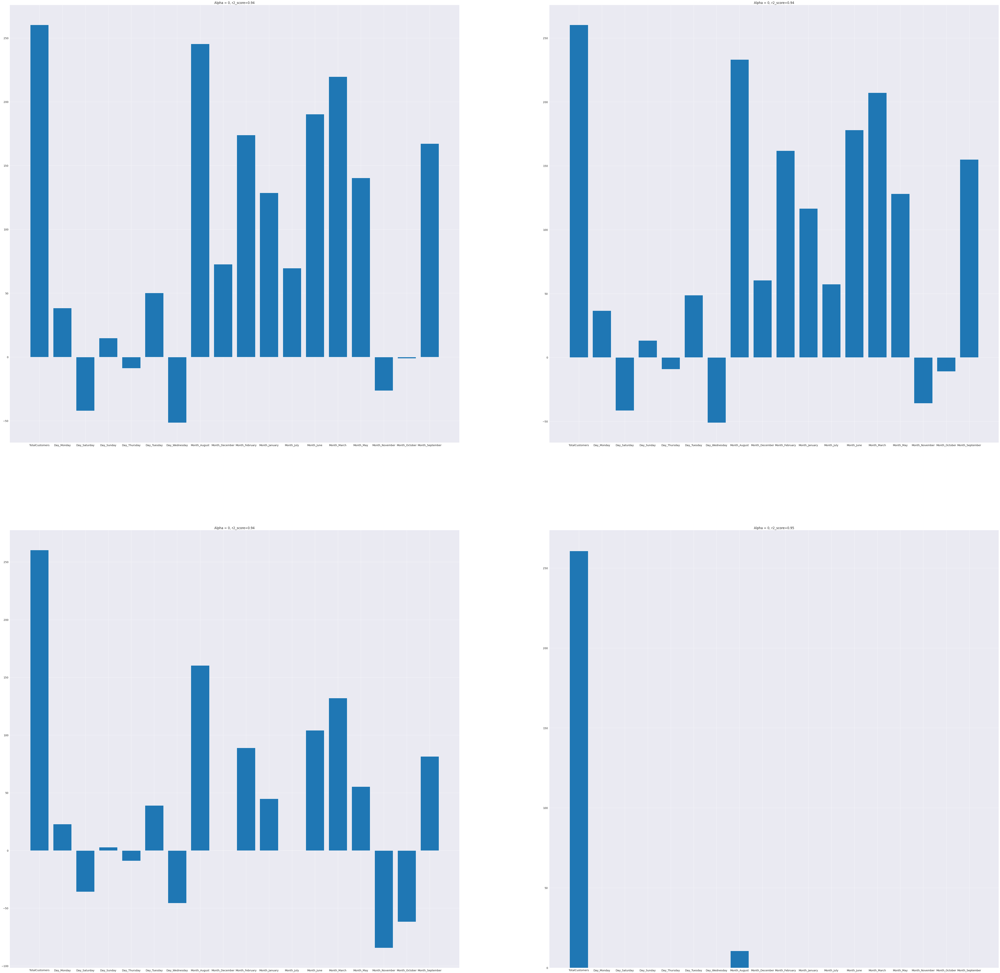

In [384]:
print(linear_5_X.columns)
plt.figure(figsize=(95,95))
plt.subplot(221)
plt.bar(linear_5_X.columns,coefs[0])
plt.title('Alpha = 0, r2_score={}'.format(round(r2_scores[0],2)))
print('Alpha = 0, r2_score={}'.format(round(r2_scores[0],2)))

plt.subplot(222)
plt.bar(linear_5_X.columns,coefs[1])
plt.title('Alpha = 0, r2_score={}'.format(round(r2_scores[1],2)))
print('Alpha = 0, r2_score={}'.format(round(r2_scores[1],2)))


plt.subplot(223)
plt.bar(linear_5_X.columns,coefs[2])
plt.title('Alpha = 0, r2_score={}'.format(round(r2_scores[2],2)))
print('Alpha = 0, r2_score={}'.format(round(r2_scores[2],2)))

plt.subplot(224)
plt.bar(linear_5_X.columns,coefs[3])
plt.title('Alpha = 0, r2_score={}'.format(round(r2_scores[3],2)))
print('Alpha = 0, r2_score={}'.format(round(r2_scores[3],2)))


In [385]:
# features : total customers, August month, june month , march month affect the most 
# use ridge when you know all features are important : L2 regularization does not eliminate the features completely
# use lasso when you know its fine to eliminate featuers : L1 regularization eleminates features 

## ElasticNet Regression (ohe)

In [387]:
#if you do not know the importance of your columns, use elastic Net regression 
#its loss function is a combination of both lasso and ridge
# also used when there is multi collinearity between input columns

In [388]:
from sklearn.linear_model import LinearRegression,ElasticNet
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

In [389]:
linear_6 = pd.get_dummies(gO1_Cost_df,drop_first=True)
linear_6

,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
0,850,5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0
1,4100,15,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0
2,7150,26,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,4050,18,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
11,2050,8,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1050,6,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
2976,3250,14,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2983,2300,7,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2984,3350,17,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [390]:
linear_6_X = linear_6.iloc[:,1:]
linear_6_y = linear_6.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(linear_6_X,linear_6_y,test_size=0.2,random_state=2)

In [391]:
l6_elasticNet = ElasticNet(alpha=0.005,l1_ratio=0.9)
l6_elasticNet.fit(X_train,y_train)

ElasticNet(alpha=0.005, l1_ratio=0.9)

In [392]:
y_pred = l6_elasticNet.predict(X_test)

In [393]:
r2_score(y_test,y_pred)

0.9431070245717262

## Regression Tree (ohe)

In [401]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn.metrics import r2_score

In [402]:
regt_1 = pd.get_dummies(gO1_Cost_df,drop_first=True)
regt_1

,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
0,850,5,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0
1,4100,15,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0
2,7150,26,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,4050,18,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0
11,2050,8,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1050,6,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
2976,3250,14,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2983,2300,7,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2984,3350,17,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [403]:
regt_1_X = regt_1.iloc[:,1:]
regt_1_y = regt_1.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(regt_1_X,regt_1_y,test_size=0.2,random_state=2)

In [404]:
regt1 = DecisionTreeRegressor(criterion='mse',max_depth = 5)
regt1.fit(X_train,y_train)

DecisionTreeRegressor(criterion='mse', max_depth=5)

In [405]:
y_pred = regt1.predict(X_test)

In [406]:
r2_score(y_test,y_pred)

0.9288565152366054

In [407]:
#hyperparameter tuning 
param_grid = {
    'max_depth':[2,4,6,8,10],
    'criterion':['mse','mae'],
    'max_features':[0.25,0.5,1.0],
    'min_samples_split':[0.25,0.5,1.0]
}
regt2= GridSearchCV(DecisionTreeRegressor(),param_grid=param_grid)
regt2.fit(X_train,y_train)

GridSearchCV(estimator=DecisionTreeRegressor(),
             param_grid={'criterion': ['mse', 'mae'],
                         'max_depth': [2, 4, 6, 8, 10],
                         'max_features': [0.25, 0.5, 1.0],
                         'min_samples_split': [0.25, 0.5, 1.0]})

In [408]:
regt2.best_score_

0.910051178478788

In [409]:
regt2.best_params_

{'criterion': 'mse',
 'max_depth': 4,
 'max_features': 1.0,
 'min_samples_split': 0.25}

In [412]:
importance_df

,feature,importance
0,TotalCustomers,0.994036
16,Month_October,0.001430
13,Month_March,0.001156
14,Month_May,0.000940
5,Day_Tuesday,0.000795
2,Day_Saturday,0.000681
17,Month_September,0.000298
10,Month_January,0.000272
1,Day_Monday,0.000236
3,Day_Sunday,0.000155


## Voting : Linear Regressor, regression tree, support vector regressor ,polynomial  (ohe) 

In [413]:
# mean of outputs of multiple models
voting_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
voting_X = regt_1.iloc[:,1:]
voting_y = regt_1.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(voting_X,voting_y,test_size=0.2,random_state=2)

In [415]:
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score


In [422]:
print(lr_2) # multiple linear regression 
print(lr_3) # polymonial regression
print(l4_ridge) # ridge regression
l5_lasso = Lasso(alpha=1)
print(l5_lasso) #lasso reg
print(l6_elasticNet) #elastic net reg
print(regt1) #decision tree regression
svr=SVR()
print(svr) #support vector regressor

LinearRegression()
LinearRegression()
Ridge(alpha=0.0001)
Lasso(alpha=1)
ElasticNet(alpha=0.005, l1_ratio=0.9)
DecisionTreeRegressor(criterion='mse', max_depth=5)
SVR()


In [423]:
estimators = [('lr_2',lr_2),('lr_3',lr_3),('l4_ridge',l4_ridge),('l5_lasso',l5_lasso),('l6_elasticNet',l6_elasticNet),('regt1',regt1),('svr',svr)]

In [424]:
estimators

[('lr_2', LinearRegression()),
 ('lr_3', LinearRegression()),
 ('l4_ridge', Ridge(alpha=0.0001)),
 ('l5_lasso', Lasso(alpha=1)),
 ('l6_elasticNet', ElasticNet(alpha=0.005, l1_ratio=0.9)),
 ('regt1', DecisionTreeRegressor(criterion='mse', max_depth=5)),
 ('svr', SVR())]

In [430]:
from sklearn.ensemble import VotingRegressor
vr = VotingRegressor(estimators)
scores = cross_val_score(vr,X_train,y_train,scoring='r2',cv=10)
print("Voting regressor : ",np.round(np.mean(scores),2))

Voting regressor :  0.93


## Bagging : Linear Regressor, regression tree, kneighbors regressor ,polynomial  (ohe) 

In [431]:
# data fed into the model in bootstrap phase is subsets of original dataset
# aggregation is done using voting 

In [432]:
bagging_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
bagging_X = regt_1.iloc[:,1:]
bagging_y = regt_1.iloc[:,0]
X_train,X_test,y_train,y_test = train_test_split(bagging_X,bagging_y,test_size=0.2,random_state=2)

In [434]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import BaggingRegressor

bag_regressor = BaggingRegressor(random_state=1)
bag_regressor.fit(X_train,y_train)

BaggingRegressor(random_state=1)

In [435]:
y_preds = bag_regressor.predict(X_test)

In [436]:
r2_score(y_test,y_preds)

0.9130761291610618

In [439]:
#finding which base estimator provides best results 
n_samples = X_train.shape[0]
n_features = X_train.shape[1]

params = {
    'base_estimator' : [lr_2,lr_3,l4_ridge,l5_lasso,l6_elasticNet,regt1,svr],
    'n_estimators':[20,50,100],
    'max_samples':[0.5,1.0],
    'max_features':[0.5,1.0],
    'bootstrap':[True,False],
    'bootstrap_features':[True,False]
}

bagging_reg_grid = GridSearchCV(BaggingRegressor(random_state=1,n_jobs=-1),param_grid=params,cv=3,n_jobs=-1,verbose=1)
bagging_reg_grid.fit(X_train,y_train)

Fitting 3 folds for each of 336 candidates, totalling 1008 fits


/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.734e+06, tolerance: 1.783e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.414e+05, tolerance: 1.799e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.492e+05, tolerance: 1.779e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.105e+06, tolerance: 1.674e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.564e+05, tolerance: 1.809e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.167e+05, tolerance: 1.817e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.014e+07, tolerance: 1.787e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.322e+07, tolerance: 1.867e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.937e+07, tolerance: 1.822e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.946e+05, tolerance: 1.688e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.290e+07, tolerance: 1.397e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.602e+07, tolerance: 1.447e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.091e+07, tolerance: 1.934e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.334e+05, tolerance: 1.953e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.338e+06, tolerance: 1.883e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.066e+07, tolerance: 1.888e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.432e+07, tolerance: 1.795e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.798e+07, tolerance: 1.588e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.075e+05, tolerance: 1.808e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.326e+07, tolerance: 1.900e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.605e+06, tolerance: 1.662e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.775e+05, tolerance: 1.634e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.670e+07, tolerance: 1.811e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.361e+06, tolerance: 1.847e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.275e+05, tolerance: 1.793e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.478e+07, tolerance: 1.870e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.986e+06, tolerance: 1.883e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.623e+05, tolerance: 1.795e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.812e+05, tolerance: 1.866e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.585e+06, tolerance: 1.733e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.768e+07, tolerance: 1.791e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.864e+06, tolerance: 1.739e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.542e+07, tolerance: 1.822e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.864e+06, tolerance: 1.739e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.306e+07, tolerance: 1.623e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.544e+07, tolerance: 1.632e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.504e+07, tolerance: 1.715e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.164e+05, tolerance: 1.713e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.799e+07, tolerance: 1.778e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.609e+07, tolerance: 1.838e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.761e+05, tolerance: 1.699e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.237e+06, tolerance: 1.767e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.109e+06, tolerance: 1.712e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.438e+06, tolerance: 1.838e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.962e+07, tolerance: 1.739e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.547e+07, tolerance: 1.699e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.065e+07, tolerance: 1.886e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.310e+07, tolerance: 1.739e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.274e+06, tolerance: 1.958e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.539e+07, tolerance: 1.838e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.556e+07, tolerance: 1.838e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.549e+07, tolerance: 1.838e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.577e+05, tolerance: 1.739e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.010e+07, tolerance: 1.739e+05
  model = cd_fast.enet_coordinate_descent(
/home/neelchoksi19bce0990/.local/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incre

GridSearchCV(cv=3, estimator=BaggingRegressor(n_jobs=-1, random_state=1),
             n_jobs=-1,
             param_grid={'base_estimator': [LinearRegression(),
                                            LinearRegression(),
                                            Ridge(alpha=0.0001), Lasso(alpha=1),
                                            ElasticNet(alpha=0.005,
                                                       l1_ratio=0.9),
                                            DecisionTreeRegressor(criterion='mse',
                                                                  max_depth=5),
                                            SVR()],
                         'bootstrap': [True, False],
                         'bootstrap_features': [True, False],
                         'max_features': [0.5, 1.0], 'max_samples': [0.5, 1.0],
                         'n_estimators': [20, 50, 100]},
             verbose=1)

In [440]:
print("Train r2 score : %.3f"%bagging_reg_grid.best_estimator_.score(X_train,y_train))
print("Test r2 score: %.3f"%bagging_reg_grid.best_estimator_.score(X_test,y_test))
print("Best r2 score through grid search : %.3f"%bagging_reg_grid.best_score_)
print("Best parameters : ",bagging_reg_grid.best_params_)

Train r2 score : 0.948
Test r2 score: 0.943
Best r2 score through grid search : 0.945
Best parameters :  {'base_estimator': Lasso(alpha=1), 'bootstrap': False, 'bootstrap_features': False, 'max_features': 1.0, 'max_samples': 0.5, 'n_estimators': 20}


## XG Boosting

# Predicting probable timeslot , sport 

In [92]:
sport_df = gO1_Cust_df[["Day","Month","Cost","Sport"]]
sport_df

,Day,Month,Cost,Sport
0,Wednesday,February,250,sport6
1,Wednesday,February,250,sport4
2,Wednesday,February,200,sport3
3,Wednesday,February,150,sport1
4,Tuesday,August,250,sport6
...,...,...,...,...
49530,Friday,January,400,sport2
49531,Friday,January,200,sport1
49532,Friday,January,200,sport2
49533,Friday,January,150,sport5


## Decision Tree

### sport

In [93]:
dt1_sport = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
dt1_sport.head()


,Day,Month,TimeSlot,Sport
0,Wednesday,February,timeslot2,sport6
1,Wednesday,February,timeslot6,sport4
2,Wednesday,February,timeslot4,sport3
3,Wednesday,February,timeslot6,sport1
4,Tuesday,August,timeslot1,sport6


In [94]:
dt1_sport_y = dt1_sport[["Sport"]]
dt1_sport_y

,Sport
0,sport6
1,sport4
2,sport3
3,sport1
4,sport6
...,...
49530,sport2
49531,sport1
49532,sport2
49533,sport5


In [96]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(dt1_sport_y)
dt1_sport_y_le = le.transform(dt1_sport_y)
print(dt1_sport_y_le.size)
print(type(dt1_sport_y_le))
dt1_sport_y_le

12348
<class 'numpy.ndarray'>


array([5, 3, 2, ..., 1, 4, 3])

In [97]:
dt1_sport_X = dt1_sport[["Day","Month","TimeSlot"]]
dt1_sport_X

,Day,Month,TimeSlot
0,Wednesday,February,timeslot2
1,Wednesday,February,timeslot6
2,Wednesday,February,timeslot4
3,Wednesday,February,timeslot6
4,Tuesday,August,timeslot1
...,...,...,...
49530,Friday,January,timeslot2
49531,Friday,January,timeslot4
49532,Friday,January,timeslot4
49533,Friday,January,timeslot6


In [98]:
dt1_sport_X_ohe = pd.get_dummies(dt1_sport_X,drop_first=True)
print(dt1_sport_X_ohe.columns)
dt1_sport_X_ohe

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'TimeSlot_timeslot2', 'TimeSlot_timeslot3',
       'TimeSlot_timeslot4', 'TimeSlot_timeslot5', 'TimeSlot_timeslot6',
       'TimeSlot_timeslot7'],
      dtype='object')


,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,...,Month_May,Month_November,Month_October,Month_September,TimeSlot_timeslot2,TimeSlot_timeslot3,TimeSlot_timeslot4,TimeSlot_timeslot5,TimeSlot_timeslot6,TimeSlot_timeslot7
0,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0
1,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49530,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,1,0,0,0,0,0
49531,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
49532,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
49533,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0


In [99]:
X_train,X_test,y_train,y_test = train_test_split(dt1_sport_X_ohe,dt1_sport_y,test_size=0.2,random_state=5)

In [100]:
print("Train shape",X_train.shape)
print("Test shape",X_test.shape)

Train shape (9878, 23)
Test shape (2470, 23)


In [101]:
from sklearn.tree import DecisionTreeClassifier
dt1_model_sport = DecisionTreeClassifier(random_state = 54)

In [102]:
dt1_model_sport.fit(X_train,y_train)

DecisionTreeClassifier(random_state=54)

In [103]:
train_preds = dt1_model_sport.predict(X_train)

In [104]:
from sklearn.metrics import accuracy_score,confusion_matrix

In [105]:
train_preds 

array(['sport3', 'sport5', 'sport2', ..., 'sport2', 'sport4', 'sport3'],
      dtype=object)

In [106]:
pd.value_counts(train_preds)

sport1    2413
sport2    2104
sport3    1739
sport4    1575
sport5    1156
sport6     891
dtype: int64

In [107]:
#training accuracy : 
accuracy_score(train_preds,y_train)

0.29894715529459404

In [108]:
# train_probs = dt1_model_sport.predict_proba(X_train)

In [109]:
# train_probs

In [110]:
dt1_model_sport.score(X_test,y_test)

0.17246963562753037

[Text(0.6032608695652174, 0.9166666666666666, 'Month_September <= 0.5\ngini = 0.833\nsamples = 9878\nvalue = [1662, 1668, 1665, 1695, 1623, 1565]'),
 Text(0.3423913043478261, 0.75, 'Month_January <= 0.5\ngini = 0.833\nsamples = 8917\nvalue = [1490, 1545, 1516, 1519, 1440, 1407]'),
 Text(0.17391304347826086, 0.5833333333333334, 'TimeSlot_timeslot2 <= 0.5\ngini = 0.833\nsamples = 8113\nvalue = [1340, 1378, 1402, 1381, 1316, 1296]'),
 Text(0.08695652173913043, 0.4166666666666667, 'TimeSlot_timeslot7 <= 0.5\ngini = 0.833\nsamples = 6930\nvalue = [1160, 1180, 1224, 1175, 1089, 1102]'),
 Text(0.043478260869565216, 0.25, 'Month_May <= 0.5\ngini = 0.833\nsamples = 5731\nvalue = [938, 1004, 1019, 951, 898, 921]'),
 Text(0.021739130434782608, 0.08333333333333333, '\n  (...)  \n'),
 Text(0.06521739130434782, 0.08333333333333333, '\n  (...)  \n'),
 Text(0.13043478260869565, 0.25, 'Month_August <= 0.5\ngini = 0.832\nsamples = 1199\nvalue = [222, 176, 205, 224, 191, 181]'),
 Text(0.10869565217391304

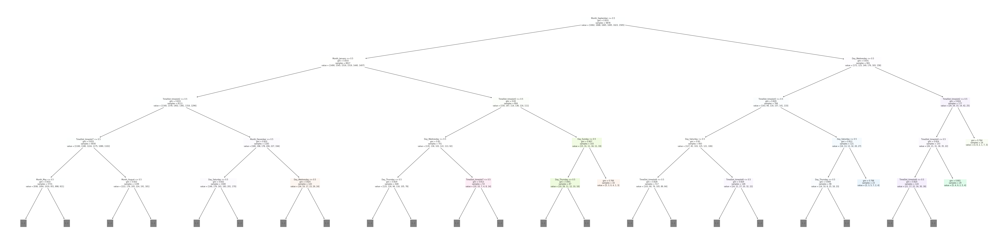

In [111]:
from sklearn.tree import plot_tree, export_text
plt.figure(figsize=(80,20))
plot_tree(dt1_model_sport,feature_names=X_train.columns,max_depth=4,filled=True)

In [112]:
# loss / cost = gini score : perfect : gini score = 0
print(dt1_model_sport.tree_.max_depth)

23


In [113]:
tree_text = export_text(dt1_model_sport,max_depth = 23, feature_names = list(X_train.columns))
print(tree_text[:50000])

|--- Month_September <= 0.50
|   |--- Month_January <= 0.50
|   |   |--- TimeSlot_timeslot2 <= 0.50
|   |   |   |--- TimeSlot_timeslot7 <= 0.50
|   |   |   |   |--- Month_May <= 0.50
|   |   |   |   |   |--- Day_Thursday <= 0.50
|   |   |   |   |   |   |--- Day_Sunday <= 0.50
|   |   |   |   |   |   |   |--- TimeSlot_timeslot5 <= 0.50
|   |   |   |   |   |   |   |   |--- Month_November <= 0.50
|   |   |   |   |   |   |   |   |   |--- TimeSlot_timeslot3 <= 0.50
|   |   |   |   |   |   |   |   |   |   |--- Month_June <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |--- Day_Saturday <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |--- Month_October <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |   |--- TimeSlot_timeslot6 <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |   |   |--- Day_Monday <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |   |   |   |--- Month_December <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |   |   |   |   |   |--- Month

In [114]:
dt1_model_sport.feature_importances_

array([0.07886806, 0.046687  , 0.03942607, 0.03328678, 0.1075881 ,
       0.07520226, 0.040047  , 0.0338529 , 0.05183094, 0.00494768,
       0.04985914, 0.03983753, 0.04417599, 0.01942138, 0.03694651,
       0.03689369, 0.00598932, 0.02054302, 0.03541054, 0.08207347,
       0.04407227, 0.05278836, 0.02025199])

In [115]:
importance_df = pd.DataFrame({
    'feature':X_train.columns,
    'importance':dt1_model_sport.feature_importances_
}).sort_values('importance',ascending=False)

In [116]:
importance_df

,feature,importance
4,Day_Tuesday,0.107588
19,TimeSlot_timeslot4,0.082073
0,Day_Monday,0.078868
5,Day_Wednesday,0.075202
21,TimeSlot_timeslot6,0.052788
8,Month_February,0.051831
10,Month_July,0.049859
1,Day_Saturday,0.046687
12,Month_March,0.044176
20,TimeSlot_timeslot5,0.044072


<AxesSubplot:title={'center':'Feature Importance'}, xlabel='importance', ylabel='feature'>

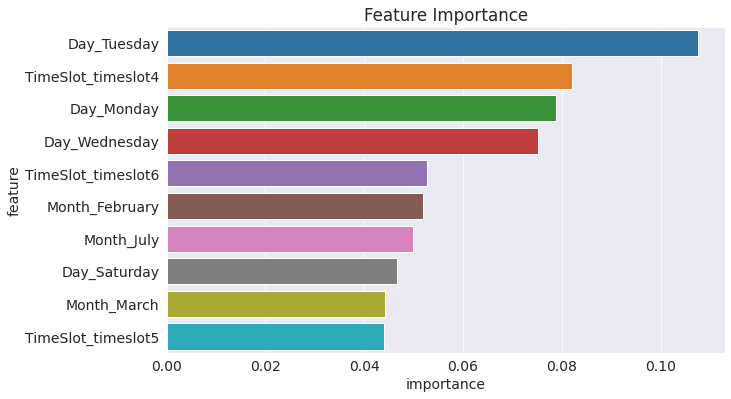

In [117]:
plt.title("Feature Importance")
sns.barplot(data= importance_df.head(10),x='importance',y='feature')

In [118]:
# regularization : reduce overfitting using hyperparameter tuning : hyperparameters are params that we specify
?DecisionTreeClassifier

In [177]:
def max_depth_error(md):
    model = DecisionTreeClassifier(max_depth = md, random_state=42)
    model.fit(X_train,y_train)
    train_err = 1- model.score(X_train,y_train)
    val_err = 1 - model.score(X_test,y_test)
    return {'Max Depth':md,'Training Error':train_err,'Validation Error':val_err}

In [178]:
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1,40)])

In [179]:
errors_df

,Max Depth,Training Error,Validation Error
0,1,0.825066,0.839676
1,2,0.821016,0.839676
2,3,0.815752,0.839676
3,4,0.810994,0.837652
4,5,0.804414,0.838057
5,6,0.800466,0.839676
6,7,0.792772,0.840081
7,8,0.784066,0.840486
8,9,0.776777,0.835223
9,10,0.766349,0.838462


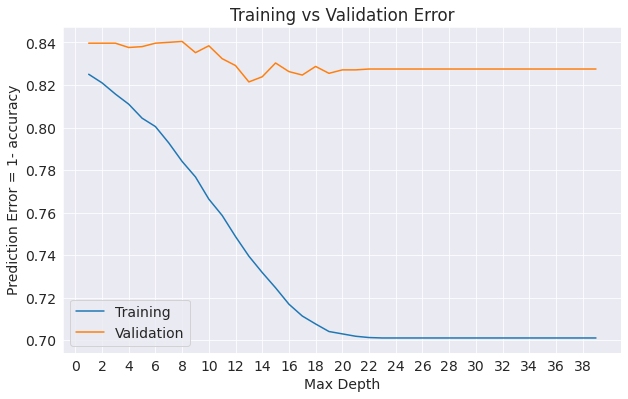

In [180]:
plt.figure()
plt.plot(errors_df['Max Depth'],errors_df['Training Error'])
plt.plot(errors_df['Max Depth'],errors_df['Validation Error'])
plt.title('Training vs Validation Error')
plt.xticks(range(0,40,2))
plt.xlabel('Max Depth')
plt.ylabel('Prediction Error = 1- accuracy')
plt.legend(['Training','Validation'])

In [182]:
# best depth for the tree is 18
model = DecisionTreeClassifier(max_depth = 18, random_state=42)
model.fit(X_train,y_train)
print(model.score(X_train,y_train))
model.score(X_test,y_test)
   

0.29236687588580684


0.17125506072874494

In [187]:
# another hyperparameter : max leaf nodes 
def max_depth_leaf_error(md,ml):
    model = DecisionTreeClassifier(max_depth = md,max_leaf_nodes=ml,random_state=42)
    model.fit(X_train,y_train)
    train_err = 1- model.score(X_train,y_train)
    val_err = 1 - model.score(X_test,y_test)
    return {'Max Depth':md,'Max Leafs':ml,'Training Error':train_err,'Validation Error':val_err}

In [192]:
errors_df = pd.DataFrame([max_depth_leaf_error(md,md+50) for md in range(1,40) ])

In [193]:
errors_df

,Max Depth,Max Leafs,Training Error,Validation Error
0,1,51,0.825066,0.839676
1,2,52,0.821016,0.839676
2,3,53,0.815752,0.839676
3,4,54,0.810994,0.837652
4,5,55,0.804414,0.838057
5,6,56,0.800466,0.839676
6,7,57,0.793076,0.839271
7,8,58,0.788014,0.839676
8,9,59,0.786698,0.838057
9,10,60,0.787103,0.830769


### timeslot

In [197]:
dt1_timeslot = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
dt1_timeslot.head()

,Day,Month,TimeSlot,Sport
0,Wednesday,February,timeslot2,sport6
1,Wednesday,February,timeslot6,sport4
2,Wednesday,February,timeslot4,sport3
3,Wednesday,February,timeslot6,sport1
4,Tuesday,August,timeslot1,sport6


In [199]:
dt1_timeslot_X = dt1_timeslot[["Day","Month","Sport"]]
dt1_timeslot_X_ohe = pd.get_dummies(dt1_timeslot_X,drop_first=True)
print(dt1_timeslot_X_ohe.columns)
dt1_timeslot_X_ohe

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'Sport_sport2', 'Sport_sport3', 'Sport_sport4',
       'Sport_sport5', 'Sport_sport6'],
      dtype='object')


,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,...,Month_March,Month_May,Month_November,Month_October,Month_September,Sport_sport2,Sport_sport3,Sport_sport4,Sport_sport5,Sport_sport6
0,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,1,0,0
2,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49530,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,1,0,0,0,0
49531,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
49532,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,1,0,0,0,0
49533,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0


In [209]:
dt1_timeslot_y = dt1_timeslot[["TimeSlot"]]
dt1_timeslot_y.describe()

,TimeSlot
count,12348
unique,7
top,timeslot7
freq,1835


In [210]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(dt1_timeslot_y)
dt1_timeslot_y_le = le.transform(dt1_timeslot_y)
print(dt1_timeslot_y_le.size)
print(type(dt1_timeslot_y_le))
dt1_timeslot_y_le

12348
<class 'numpy.ndarray'>


array([1, 5, 3, ..., 3, 5, 3])

In [211]:
X_train,X_test,y_train,y_test = train_test_split(dt1_timeslot_X_ohe,dt1_timeslot_y,test_size=0.2,random_state=5)

In [212]:
print("Train shape",X_train.shape)
print("Test shape",X_test.shape)

Train shape (9878, 22)
Test shape (2470, 22)


In [213]:
from sklearn.tree import DecisionTreeClassifier
dt1_model_timeslot = DecisionTreeClassifier(random_state = 54)

In [214]:
dt1_model_timeslot.fit(X_train,y_train)

DecisionTreeClassifier(random_state=54)

In [215]:
train_preds = dt1_model_timeslot.predict(X_train)

In [216]:
from sklearn.metrics import accuracy_score,confusion_matrix

In [217]:
train_preds 

array(['timeslot3', 'timeslot6', 'timeslot7', ..., 'timeslot6',
       'timeslot5', 'timeslot4'], dtype=object)

In [218]:
pd.value_counts(train_preds)

timeslot1    2095
timeslot2    1716
timeslot3    1672
timeslot5    1170
timeslot4    1162
timeslot6    1054
timeslot7    1009
dtype: int64

In [219]:
#training accuracy : 
accuracy_score(train_preds,y_train)

0.26341364648714316

In [220]:
dt1_model_timeslot.score(X_test,y_test)

0.145748987854251

[Text(0.6032608695652174, 0.9166666666666666, 'Month_January <= 0.5\ngini = 0.857\nsamples = 9878\nvalue = [1382, 1433, 1469, 1375, 1361, 1424, 1434]'),
 Text(0.3423913043478261, 0.75, 'Month_May <= 0.5\ngini = 0.857\nsamples = 9074\nvalue = [1274, 1319, 1366, 1240, 1248, 1295, 1332]'),
 Text(0.17391304347826086, 0.5833333333333334, 'Month_August <= 0.5\ngini = 0.857\nsamples = 8106\nvalue = [1134, 1160, 1232, 1104, 1125, 1140, 1211]'),
 Text(0.08695652173913043, 0.4166666666666667, 'Sport_sport2 <= 0.5\ngini = 0.857\nsamples = 7222\nvalue = [1038, 1029, 1101, 981, 1002, 1001, 1070]'),
 Text(0.043478260869565216, 0.25, 'Month_July <= 0.5\ngini = 0.857\nsamples = 6036\nvalue = [847, 853, 917, 827, 841, 824, 927]'),
 Text(0.021739130434782608, 0.08333333333333333, '\n  (...)  \n'),
 Text(0.06521739130434782, 0.08333333333333333, '\n  (...)  \n'),
 Text(0.13043478260869565, 0.25, 'Day_Monday <= 0.5\ngini = 0.856\nsamples = 1186\nvalue = [191, 176, 184, 154, 161, 177, 143]'),
 Text(0.10869

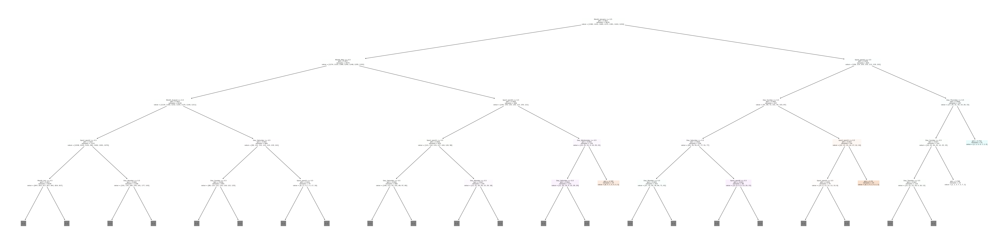

In [221]:
from sklearn.tree import plot_tree, export_text
plt.figure(figsize=(80,20))
plot_tree(dt1_model_timeslot,feature_names=X_train.columns,max_depth=4,filled=True)

In [224]:
# loss / cost = gini score : perfect : gini score = 0
print(dt1_model_timeslot.tree_.max_depth)

22


In [225]:
dt1_model_timeslot.feature_importances_

array([0.0948505 , 0.05793505, 0.07704014, 0.08407547, 0.10282372,
       0.07421292, 0.00325979, 0.03086111, 0.05285933, 0.00388211,
       0.01114201, 0.0348447 , 0.05482475, 0.00360413, 0.05166714,
       0.0520481 , 0.0331098 , 0.02490036, 0.04247825, 0.03864454,
       0.0384591 , 0.03247699])

In [226]:
importance_df = pd.DataFrame({
    'feature':X_train.columns,
    'importance':dt1_model_timeslot.feature_importances_
}).sort_values('importance',ascending=False)

In [227]:
importance_df

,feature,importance
4,Day_Tuesday,0.102824
0,Day_Monday,0.094850
3,Day_Thursday,0.084075
2,Day_Sunday,0.077040
5,Day_Wednesday,0.074213
1,Day_Saturday,0.057935
12,Month_March,0.054825
8,Month_February,0.052859
15,Month_October,0.052048
14,Month_November,0.051667


<AxesSubplot:title={'center':'Feature Importance'}, xlabel='importance', ylabel='feature'>

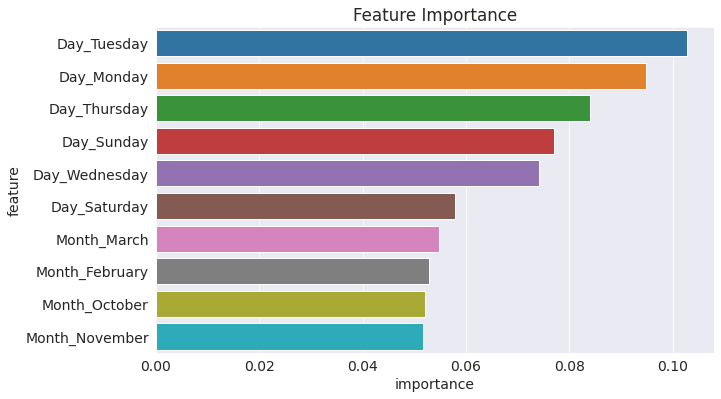

In [228]:
plt.title("Feature Importance")
sns.barplot(data= importance_df.head(10),x='importance',y='feature')

In [229]:
def max_depth_error(md):
    model = DecisionTreeClassifier(max_depth = md, random_state=42)
    model.fit(X_train,y_train)
    train_err = 1- model.score(X_train,y_train)
    val_err = 1 - model.score(X_test,y_test)
    return {'Max Depth':md,'Training Error':train_err,'Validation Error':val_err}

In [230]:
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1,40)])

In [231]:
errors_df

,Max Depth,Training Error,Validation Error
0,1,0.848046,0.855870
1,2,0.845313,0.857895
2,3,0.842782,0.857085
3,4,0.838631,0.841296
4,5,0.831747,0.853846
5,6,0.825268,0.860324
6,7,0.816967,0.854656
7,8,0.808564,0.853846
8,9,0.798239,0.855870
9,10,0.790342,0.855466


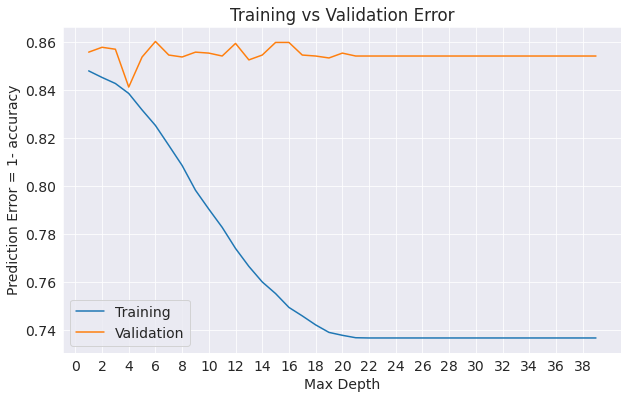

In [232]:
plt.figure()
plt.plot(errors_df['Max Depth'],errors_df['Training Error'])
plt.plot(errors_df['Max Depth'],errors_df['Validation Error'])
plt.title('Training vs Validation Error')
plt.xticks(range(0,40,2))
plt.xlabel('Max Depth')
plt.ylabel('Prediction Error = 1- accuracy')
plt.legend(['Training','Validation'])

In [233]:
# best depth for the tree is 4
model = DecisionTreeClassifier(max_depth = 4, random_state=42)
model.fit(X_train,y_train)
print(model.score(X_train,y_train))
model.score(X_test,y_test)
   

0.16136869811702773


0.15870445344129555

In [234]:
# another hyperparameter : max leaf nodes 
def max_depth_leaf_error(md,ml):
    model = DecisionTreeClassifier(max_depth = md,max_leaf_nodes=ml,random_state=42)
    model.fit(X_train,y_train)
    train_err = 1- model.score(X_train,y_train)
    val_err = 1 - model.score(X_test,y_test)
    return {'Max Depth':md,'Max Leafs':ml,'Training Error':train_err,'Validation Error':val_err}

In [245]:
errors_df = pd.DataFrame([max_depth_leaf_error(md,md+150) for md in range(1,40) ])

In [246]:
errors_df

,Max Depth,Max Leafs,Training Error,Validation Error
0,1,151,0.848046,0.855870
1,2,152,0.845313,0.857895
2,3,153,0.842782,0.857085
3,4,154,0.838631,0.841296
4,5,155,0.831747,0.853846
5,6,156,0.825268,0.860324
6,7,157,0.816967,0.854656
7,8,158,0.808564,0.853846
8,9,159,0.798239,0.855870
9,10,160,0.790342,0.855870


## Random Forest 

In [247]:
#most commonly occuring class
from sklearn.ensemble import RandomForestClassifier

In [248]:
rf_sport = RandomForestClassifier(n_jobs=-1,random_state=42)

In [249]:
X_train,X_test,y_train,y_test = train_test_split(dt1_sport_X_ohe,dt1_sport_y,test_size=0.2,random_state=5)

In [250]:
rf_sport.fit(X_train,y_train)

RandomForestClassifier(n_jobs=-1, random_state=42)

In [251]:
rf_sport.score(X_train,y_train)

0.29884592022676654

In [252]:
rf_sport.score(X_test,y_test)

0.17530364372469637

In [253]:
importance_df = pd.DataFrame({
    'feature':X_train.columns,
    'importance':rf_sport.feature_importances_
}).sort_values('importance',ascending=False)

In [254]:
importance_df

,feature,importance
3,Day_Thursday,0.063572
0,Day_Monday,0.062469
5,Day_Wednesday,0.060603
19,TimeSlot_timeslot4,0.059204
20,TimeSlot_timeslot5,0.058866
2,Day_Sunday,0.056921
18,TimeSlot_timeslot3,0.054077
4,Day_Tuesday,0.053387
21,TimeSlot_timeslot6,0.052498
1,Day_Saturday,0.051995


<AxesSubplot:title={'center':'Feature Importance'}, xlabel='importance', ylabel='feature'>

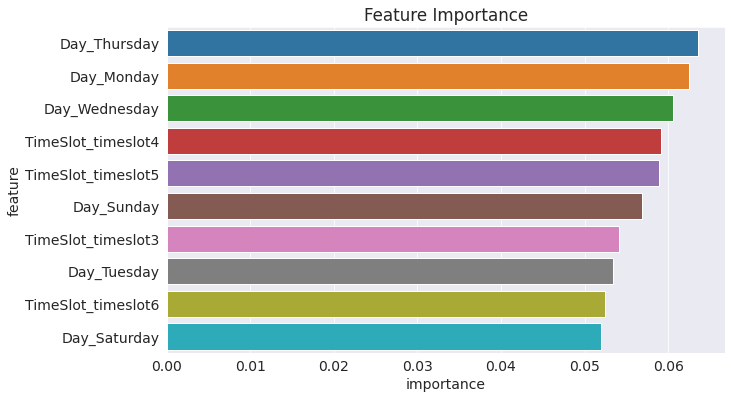

In [255]:
plt.title("Feature Importance")
sns.barplot(data= importance_df.head(10),x='importance',y='feature')

In [ ]:
#hyperparameter tuning 


## Voting Classification 

### sport

In [441]:
vt1_sport = gO1_Cust_df[["Day","Month","TimeSlot","Sport"]]
vt1_sport.head()

,Day,Month,TimeSlot,Sport
0,Wednesday,February,timeslot2,sport6
1,Wednesday,February,timeslot6,sport4
2,Wednesday,February,timeslot4,sport3
3,Wednesday,February,timeslot6,sport1
4,Tuesday,August,timeslot1,sport6


In [442]:
vt1_sport_y = vt1_sport[["Sport"]]
y=vt1_sport_y
y


,Sport
0,sport6
1,sport4
2,sport3
3,sport1
4,sport6
...,...
49530,sport2
49531,sport1
49532,sport2
49533,sport5


In [443]:
vt1_sport_X = vt1_sport[["Day","Month","TimeSlot"]]
X=vt1_sport_X

X_ohe = pd.get_dummies(X,drop_first=True)
print(X_ohe.columns)
X_ohe

Index(['Day_Monday', 'Day_Saturday', 'Day_Sunday', 'Day_Thursday',
       'Day_Tuesday', 'Day_Wednesday', 'Month_August', 'Month_December',
       'Month_February', 'Month_January', 'Month_July', 'Month_June',
       'Month_March', 'Month_May', 'Month_November', 'Month_October',
       'Month_September', 'TimeSlot_timeslot2', 'TimeSlot_timeslot3',
       'TimeSlot_timeslot4', 'TimeSlot_timeslot5', 'TimeSlot_timeslot6',
       'TimeSlot_timeslot7'],
      dtype='object')


,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,...,Month_May,Month_November,Month_October,Month_September,TimeSlot_timeslot2,TimeSlot_timeslot3,TimeSlot_timeslot4,TimeSlot_timeslot5,TimeSlot_timeslot6,TimeSlot_timeslot7
0,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0
1,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49530,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,1,0,0,0,0,0
49531,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
49532,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
49533,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0


In [445]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(vt1_sport_y)
vt1_sport_y_le = le.transform(vt1_sport_y)
print(vt1_sport_y_le.size)
print(type(vt1_sport_y_le))
y=vt1_sport_y_le

12348
<class 'numpy.ndarray'>


In [455]:
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score

In [456]:
vt_clf1 = LogisticRegression()
vt_clf2 = RandomForestClassifier()
vt_clf3 = KNeighborsClassifier()
vt_clf4 = DecisionTreeClassifier(max_depth = 18, random_state=42)

In [457]:
estimators = [('logr',vt_clf1),('rf',vt_clf2),('knn',vt_clf3),('dt',vt_clf4)]

In [458]:
for estimator in estimators :
#     print(estimator[0])
    x = cross_val_score(estimator[1],X_ohe,y,cv=10,scoring='accuracy')
    print(estimator[0],np.round(np.mean(x),2))

logr 0.17
rf 0.16
knn 0.16
dt 0.17


In [459]:
from sklearn.ensemble import VotingClassifier


In [461]:
# hard voting : 
voting_sport = VotingClassifier(estimators = estimators,voting="hard")
x = cross_val_score(voting_sport,X_ohe,y,cv=10,scoring='accuracy')
print(np.round(np.mean(x),2))

0.16


In [462]:
# soft voting : 
voting_sport = VotingClassifier(estimators = estimators,voting="soft")
x = cross_val_score(voting_sport,X_ohe,y,cv=10,scoring='accuracy')
print(np.round(np.mean(x),2))

0.16


### timeslot

## Bagging Classification

### sport 

### timeslot

## Stacking

## ADA boosting